In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, date
import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
df_patients = pd.read_csv('data/csv/patients.csv')

df_patients['BIRTHDATE']=pd.to_datetime(df_patients['BIRTHDATE'])
df_patients['DEATHDATE'].fillna(date.today(),inplace=True)
df_patients['DEATHDATE']=pd.to_datetime(df_patients['DEATHDATE'])
df_patients['AGE'] = ((df_patients['DEATHDATE']-df_patients['BIRTHDATE'])/np.timedelta64(1,'Y')).astype(int)

columns_drop = [ 'SSN', 'DRIVERS', 'PASSPORT',
                'FIRST', 'LAST', 'SUFFIX', 'MAIDEN', 'MARITAL', 'PREFIX',  'RACE',  'ETHNICITY',
                'BIRTHPLACE',	'ADDRESS',	'CITY',	'STATE'	,'COUNTY'	,'ZIP',	'LAT',	'LON']
df_patients.drop(columns=columns_drop, inplace=True)

df_patients.head()



,Id,BIRTHDATE,DEATHDATE,GENDER,HEALTHCARE_EXPENSES,HEALTHCARE_COVERAGE,AGE
0,7d3e489a-7789-9cd6-2a1b-711074af481b,1993-04-09,2021-01-14,M,571009.99,2243.96,27
1,9bafdf36-6e60-e93e-7925-c8d15a49ea62,1954-12-20,2021-01-14,F,683866.03,7635.71,66
2,a3795ec8-54f3-e99e-a4b1-4c067f3141d7,2004-04-25,2021-01-14,M,344034.62,2834.80,16
3,e74107cd-69f6-56b0-b7b2-70d82d50ad4e,2001-12-10,2021-01-14,F,416279.01,2808.02,19
4,3829c803-1f4c-74ed-0d8f-36e502cadd0f,2005-03-20,2021-01-14,M,344744.51,2845.61,15


In [3]:
df_patients['Id'].drop_duplicates().count()

5924

In [4]:
df_conditions = pd.read_csv('data/csv/conditions.csv')

df_conditions['DESCRIPTION'] = df_conditions['DESCRIPTION'].str.lower()
df_conditions['code_diabetes'] = 0
df_conditions.loc[
    df_conditions['DESCRIPTION'].str.contains('diabetes'),'code_diabetes'] = 1
df_conditions.loc[
    df_conditions['DESCRIPTION'].str.contains('diabetic'),'code_diabetes'] = 1

df_conditions.head()


,START,STOP,PATIENT,ENCOUNTER,CODE,DESCRIPTION,code_diabetes
0,2010-05-28,NaN,7d3e489a-7789-9cd6-2a1b-711074af481b,352781cb-51fd-f852-238f-2ad23e342731,162864005,body mass index 30+ - obesity (finding),0
1,2011-06-23,2011-06-30,e74107cd-69f6-56b0-b7b2-70d82d50ad4e,bf064dd6-5ec6-8da9-44af-4222c45fd08b,444814009,viral sinusitis (disorder),0
2,1958-08-05,NaN,9bafdf36-6e60-e93e-7925-c8d15a49ea62,25faf790-f751-438b-ed7a-f23c8d512cfd,40055000,chronic sinusitis (disorder),0
3,1985-12-16,NaN,9bafdf36-6e60-e93e-7925-c8d15a49ea62,716d452d-cd40-c01f-66dc-d7ed35a7057a,19169002,miscarriage in first trimester,0
4,1986-03-03,NaN,9bafdf36-6e60-e93e-7925-c8d15a49ea62,4e199705-8615-bbf4-e894-431e2a8cb29b,162864005,body mass index 30+ - obesity (finding),0


In [5]:
df_conditions_diabetes = df_conditions.groupby('PATIENT',as_index=False)['code_diabetes'].sum()
df_conditions_diabetes.loc[df_conditions_diabetes['code_diabetes']>0,'code_diabetes']=1
df_conditions_diabetes.rename(columns={'PATIENT':'Id'},inplace=True)
df_conditions_diabetes.head()

,Id,code_diabetes
0,0009cbbc-2c82-5c29-1cd4-1ab058a2d2a5,1
1,0018b44e-3a26-18e1-18e6-0fb9618f9603,0
2,0025adcb-9bde-f0a6-f69e-5ab349e298e3,0
3,002986c5-354d-bb9d-c180-4ce26813ca28,0
4,002ac222-5e0b-0e5a-1755-90e2c4b22840,1


In [6]:
df_observations = pd.read_csv('data/csv/observations.csv')
df_observations.head()

,DATE,PATIENT,ENCOUNTER,CODE,DESCRIPTION,VALUE,UNITS,TYPE
0,2011-04-17T07:18:08Z,a3795ec8-54f3-e99e-a4b1-4c067f3141d7,cdfce94c-98f2-5331-6868-b86da30ee994,8302-2,Body Height,122.2,cm,numeric
1,2011-03-29T01:52:13Z,a074203a-4773-9330-fc6a-06307ed6b3d7,76e82eab-c1ce-1677-9f8c-0bb5c07d3328,8302-2,Body Height,166.9,cm,numeric
2,2011-04-17T07:18:08Z,a3795ec8-54f3-e99e-a4b1-4c067f3141d7,cdfce94c-98f2-5331-6868-b86da30ee994,72514-3,Pain severity - 0-10 verbal numeric rating [Sc...,2.0,{score},numeric
3,2011-03-29T01:52:13Z,a074203a-4773-9330-fc6a-06307ed6b3d7,76e82eab-c1ce-1677-9f8c-0bb5c07d3328,72514-3,Pain severity - 0-10 verbal numeric rating [Sc...,2.0,{score},numeric
4,2011-04-17T07:18:08Z,a3795ec8-54f3-e99e-a4b1-4c067f3141d7,cdfce94c-98f2-5331-6868-b86da30ee994,29463-7,Body Weight,22.1,kg,numeric


In [7]:
list_obs = [
    'Diastolic Blood Pressure',
    'Glucose',
    'Body Mass Index'
]
df_observations_to_diabetes = df_observations[df_observations['DESCRIPTION'].isin(list_obs)]
df_observations_to_diabetes.head()

,DATE,PATIENT,ENCOUNTER,CODE,DESCRIPTION,VALUE,UNITS,TYPE
6,2011-04-17T07:18:08Z,a3795ec8-54f3-e99e-a4b1-4c067f3141d7,cdfce94c-98f2-5331-6868-b86da30ee994,39156-5,Body Mass Index,14.8,kg/m2,numeric
7,2011-03-29T01:52:13Z,a074203a-4773-9330-fc6a-06307ed6b3d7,76e82eab-c1ce-1677-9f8c-0bb5c07d3328,39156-5,Body Mass Index,29.7,kg/m2,numeric
9,2011-03-29T01:52:13Z,a074203a-4773-9330-fc6a-06307ed6b3d7,76e82eab-c1ce-1677-9f8c-0bb5c07d3328,8462-4,Diastolic Blood Pressure,86.0,mm[Hg],numeric
10,2011-04-17T07:18:08Z,a3795ec8-54f3-e99e-a4b1-4c067f3141d7,cdfce94c-98f2-5331-6868-b86da30ee994,8462-4,Diastolic Blood Pressure,85.0,mm[Hg],numeric
17,2011-03-29T01:52:13Z,a074203a-4773-9330-fc6a-06307ed6b3d7,76e82eab-c1ce-1677-9f8c-0bb5c07d3328,2339-0,Glucose,73.9,mg/dL,numeric


In [8]:
df_observations_to_diabetes[['DESCRIPTION','UNITS']].drop_duplicates()

,DESCRIPTION,UNITS
6,Body Mass Index,kg/m2
9,Diastolic Blood Pressure,mm[Hg]
17,Glucose,mg/dL


In [9]:
def get_data_obs(df,field_value):    
    df = df[df['DESCRIPTION']==field_value].rename(columns={'VALUE':field_value,'PATIENT':'Id'})
    control_datetime = df.groupby(['Id','DESCRIPTION'],as_index=False)['DATE'].max()    
    df=df[df['DATE'].isin(control_datetime['DATE'])]
    
    return df[['Id',field_value]]

In [10]:
df_observations_to_diabetes_result= pd.merge(
    get_data_obs(df_observations_to_diabetes,'Diastolic Blood Pressure'),
    get_data_obs(df_observations_to_diabetes,'Glucose'),
    on='Id'
).merge(
    get_data_obs(df_observations_to_diabetes,'Body Mass Index'),    
    on='Id'
)
df_observations_to_diabetes_result.head(10)

,Id,Diastolic Blood Pressure,Glucose,Body Mass Index
0,a074203a-4773-9330-fc6a-06307ed6b3d7,82.0,75.8,29.1
1,79981661-8e0a-e0ba-6c1d-9b7f58ce8ec3,74.0,87.4,28.6
2,69026ae4-67c9-de5a-4326-588955333063,87.0,69.1,28.2
3,ddd927f8-f1e6-2517-02ce-026c850b2ebf,79.0,81.1,32.7
4,37d96a0f-ead9-7a28-1c27-42a2da0c0c97,87.0,91.9,29.3
5,759bcb17-b3a8-6a0e-f4c3-fd5cffe45397,82.0,77.4,29.4
6,5532d02a-e9d7-b9a4-b8db-45036594eb56,79.0,88.3,28.5
7,5553e0c0-b41e-d55c-66a7-13a8e6404c48,83.0,65.2,22.9
8,58de8234-c5d3-0fb0-3057-6bf4c06ea7df,83.0,83.5,32.6
9,a2e0c2db-b6dc-2600-dfd1-da0f12ac22de,78.0,79.7,28.7


In [11]:
df_observations_to_diabetes_result.shape


(3200, 4)

In [12]:
df_to_traine = df_patients.merge(right=df_conditions_diabetes,how='left',on='Id').merge(right=df_observations_to_diabetes_result,how='left',on='Id')
df_to_traine.loc[df_to_traine['GENDER']=='F','GENDER']=1
df_to_traine.loc[df_to_traine['GENDER']=='M','GENDER']=0

df_to_traine.index=df_to_traine['Id']

df_to_traine.drop(columns=['Id','BIRTHDATE','DEATHDATE'],inplace=True)
df_to_traine = df_to_traine[['GENDER','HEALTHCARE_EXPENSES','HEALTHCARE_COVERAGE','AGE','Diastolic Blood Pressure','Glucose','Body Mass Index','code_diabetes']]

df_to_traine.head()

,GENDER,HEALTHCARE_EXPENSES,HEALTHCARE_COVERAGE,AGE,Diastolic Blood Pressure,Glucose,Body Mass Index,code_diabetes
Id,,,,,,,,
7d3e489a-7789-9cd6-2a1b-711074af481b,0,571009.99,2243.96,27,NaN,NaN,NaN,0.0
9bafdf36-6e60-e93e-7925-c8d15a49ea62,1,683866.03,7635.71,66,NaN,NaN,NaN,0.0
a3795ec8-54f3-e99e-a4b1-4c067f3141d7,0,344034.62,2834.80,16,NaN,NaN,NaN,0.0
e74107cd-69f6-56b0-b7b2-70d82d50ad4e,1,416279.01,2808.02,19,NaN,NaN,NaN,0.0
3829c803-1f4c-74ed-0d8f-36e502cadd0f,0,344744.51,2845.61,15,NaN,NaN,NaN,0.0


In [13]:
df_to_traine.shape

(6874, 8)

In [14]:
df_to_traine[list_obs]=df_to_traine[list_obs].astype('float64')
df_to_traine[['GENDER','code_diabetes']]=df_to_traine[['GENDER','code_diabetes']].astype('float64')

In [15]:
df_to_traine = df_to_traine[df_to_traine['code_diabetes'].notna()]

In [16]:
df_to_traine.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6833 entries, 7d3e489a-7789-9cd6-2a1b-711074af481b to a780880f-606b-143c-a5ee-3374811d4f16
Data columns (total 8 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   GENDER                    6833 non-null   float64
 1   HEALTHCARE_EXPENSES       6833 non-null   float64
 2   HEALTHCARE_COVERAGE       6833 non-null   float64
 3   AGE                       6833 non-null   int32  
 4   Diastolic Blood Pressure  3200 non-null   float64
 5   Glucose                   3200 non-null   float64
 6   Body Mass Index           3200 non-null   float64
 7   code_diabetes             6833 non-null   float64
dtypes: float64(7), int32(1)
memory usage: 453.8+ KB


In [17]:
df_to_traine.describe().T.round(3)

,count,mean,std,min,25%,50%,75%,max
GENDER,6833.0,0.503,0.500,0.00,0.00,1.00,1.00,1.00
HEALTHCARE_EXPENSES,6833.0,878745.164,563901.703,774.96,325044.48,933733.66,1421557.75,2086604.61
HEALTHCARE_COVERAGE,6833.0,11215.371,28464.098,0.00,3053.89,5906.05,10951.51,431232.39
AGE,6833.0,47.907,26.226,0.00,25.00,49.00,69.00,110.00
Diastolic Blood Pressure,3200.0,82.149,9.208,67.00,76.00,80.50,85.00,120.00
Glucose,3200.0,85.058,14.348,64.00,74.30,83.90,93.50,199.10
Body Mass Index,3200.0,28.729,2.408,16.10,27.70,28.20,30.10,49.20
code_diabetes,6833.0,0.402,0.490,0.00,0.00,0.00,1.00,1.00


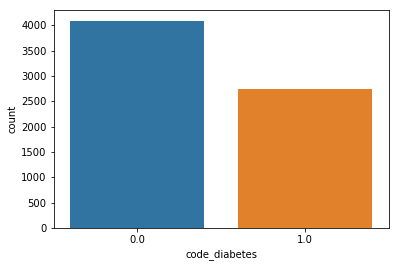

In [18]:
sns.countplot(x = 'code_diabetes',data = df_to_traine)

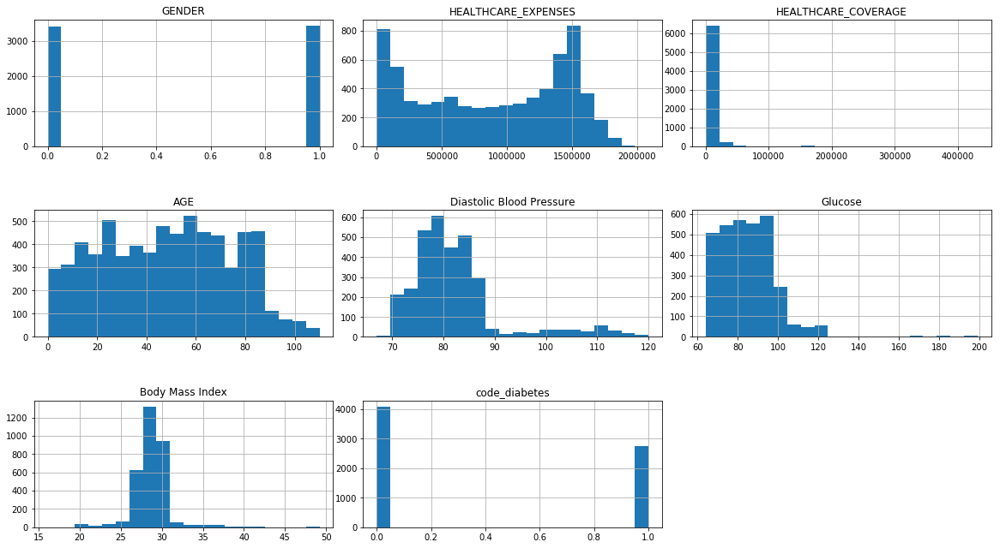

In [19]:
import itertools

col = df_to_traine.columns
plt.subplots(figsize = (20, 15))
length = len(col)

for i, j in itertools.zip_longest(col, range(length)):
    plt.subplot((length/2), 3, j + 1)
    plt.subplots_adjust(wspace = 0.1,hspace = 0.5)
    df_to_traine[i].hist(bins = 20)
    plt.title(i)
plt.show()

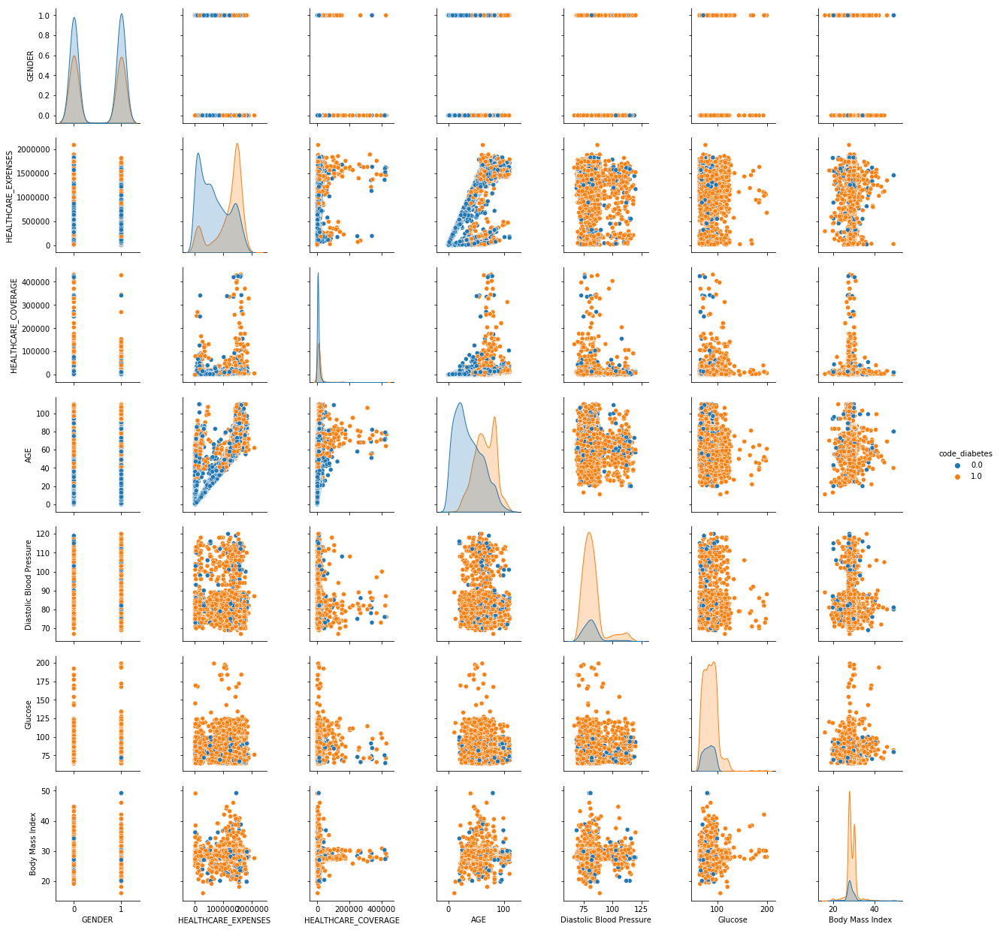

In [20]:
sns.pairplot(data = df_to_traine,hue='code_diabetes')
plt.show()

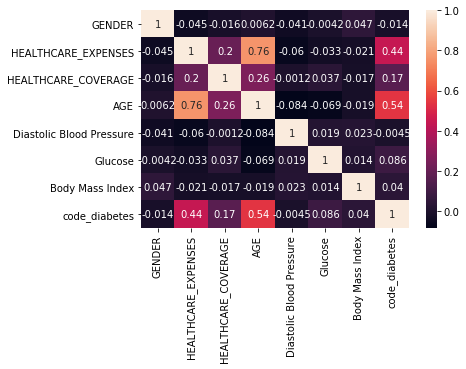

In [21]:
sns.heatmap(df_to_traine.corr(), annot = True)
plt.show()

In [22]:
df_to_traine.isnull().sum()

GENDER                         0
HEALTHCARE_EXPENSES            0
HEALTHCARE_COVERAGE            0
AGE                            0
Diastolic Blood Pressure    3633
Glucose                     3633
Body Mass Index             3633
code_diabetes                  0
dtype: int64

In [23]:
for obs in list_obs:
    df_to_traine[obs].fillna(df_to_traine[obs].mean(), inplace = True)
df_to_traine.isnull().sum()



GENDER                      0
HEALTHCARE_EXPENSES         0
HEALTHCARE_COVERAGE         0
AGE                         0
Diastolic Blood Pressure    0
Glucose                     0
Body Mass Index             0
code_diabetes               0
dtype: int64

In [24]:
df_to_traine.describe().T

,count,mean,std,min,25%,50%,75%,max
GENDER,6833.0,0.502707,0.500029,0.00,0.000000,1.000000,1.000000e+00,1.00
HEALTHCARE_EXPENSES,6833.0,878745.164401,563901.703012,774.96,325044.480000,933733.660000,1.421558e+06,2086604.61
HEALTHCARE_COVERAGE,6833.0,11215.371260,28464.098181,0.00,3053.890000,5906.050000,1.095151e+04,431232.39
AGE,6833.0,47.907361,26.226429,0.00,25.000000,49.000000,6.900000e+01,110.00
Diastolic Blood Pressure,6833.0,82.148750,6.300873,67.00,81.000000,82.148750,8.214875e+01,120.00
Glucose,6833.0,85.057875,9.817828,64.00,85.057875,85.057875,8.505787e+01,199.10
Body Mass Index,6833.0,28.729188,1.647447,16.10,28.400000,28.729187,2.872919e+01,49.20
code_diabetes,6833.0,0.402020,0.490342,0.00,0.000000,0.000000,1.000000e+00,1.00


In [25]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0, 1))
dataset_scaled = pd.DataFrame(sc.fit_transform(df_to_traine))
dataset_scaled.head()


,0,1,2,3,4,5,6,7
0,0.0,0.273385,0.005204,0.245455,0.285825,0.155869,0.381546,0.0
1,1.0,0.327491,0.017707,0.600000,0.285825,0.155869,0.381546,0.0
2,0.0,0.164567,0.006574,0.145455,0.285825,0.155869,0.381546,0.0
3,1.0,0.199203,0.006512,0.172727,0.285825,0.155869,0.381546,0.0
4,0.0,0.164908,0.006599,0.136364,0.285825,0.155869,0.381546,0.0


In [26]:
columns_list = list(dataset_scaled.columns)

X = dataset_scaled.iloc[:, columns_list[:len(columns_list)-1]].values
Y = dataset_scaled.iloc[:, columns_list[-1]].values

In [27]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.30, random_state = 13, stratify = df_to_traine['code_diabetes'] )

In [28]:
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("Y_train shape:", Y_train.shape)
print("Y_test shape:", Y_test.shape)

X_train shape: (4783, 7)
X_test shape: (2050, 7)
Y_train shape: (4783,)
Y_test shape: (2050,)


In [29]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(random_state = 13)
logreg.fit(X_train, Y_train)

LogisticRegression(random_state=13)

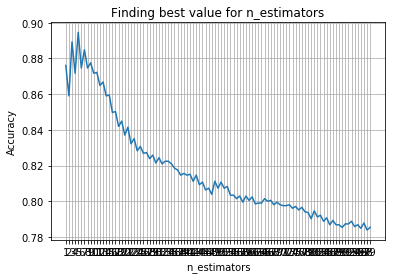

Highest value:  0.8946341463414634


In [30]:
from sklearn import metrics
from sklearn.neighbors import KNeighborsClassifier

steps = 100

X_axis = list(range(1, steps))
acc = pd.Series()
x = range(1,steps)

for i in list(range(1, steps)):
    knn_model = KNeighborsClassifier(n_neighbors = i) 
    knn_model.fit(X_train, Y_train)
    prediction = knn_model.predict(X_test)
    acc = acc.append(pd.Series(metrics.accuracy_score(prediction, Y_test)))
plt.plot(X_axis, acc)
plt.xticks(x)
plt.title("Finding best value for n_estimators")
plt.xlabel("n_estimators")
plt.ylabel("Accuracy")
plt.grid()
plt.show()
print('Highest value: ',acc.values.max())

In [31]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 13, metric = 'minkowski', p = 2)
knn.fit(X_train, Y_train)

KNeighborsClassifier(n_neighbors=13)

In [32]:
from sklearn.svm import SVC
svc = SVC(kernel = 'linear', random_state = 13)
svc.fit(X_train, Y_train)

SVC(kernel='linear', random_state=13)

In [33]:
from sklearn.naive_bayes import GaussianNB
nb = GaussianNB()
nb.fit(X_train, Y_train)

GaussianNB()

In [34]:
from sklearn.tree import DecisionTreeClassifier
dectree = DecisionTreeClassifier(criterion = 'entropy', random_state = 13)
dectree.fit(X_train, Y_train)

DecisionTreeClassifier(criterion='entropy', random_state=13)

In [35]:
from sklearn.ensemble import RandomForestClassifier
ranfor = RandomForestClassifier(n_estimators = 11, criterion = 'entropy', random_state = 13)
ranfor.fit(X_train, Y_train)

RandomForestClassifier(criterion='entropy', n_estimators=11, random_state=13)

In [36]:
Y_pred_logreg = logreg.predict(X_test)
Y_pred_knn = knn.predict(X_test)
Y_pred_svc = svc.predict(X_test)
Y_pred_nb = nb.predict(X_test)
Y_pred_dectree = dectree.predict(X_test)
Y_pred_ranfor = ranfor.predict(X_test)

In [37]:
from sklearn.metrics import accuracy_score
accuracy_logreg = accuracy_score(Y_test, Y_pred_logreg)
accuracy_knn = accuracy_score(Y_test, Y_pred_knn)
accuracy_svc = accuracy_score(Y_test, Y_pred_svc)
accuracy_nb = accuracy_score(Y_test, Y_pred_nb)
accuracy_dectree = accuracy_score(Y_test, Y_pred_dectree)
accuracy_ranfor = accuracy_score(Y_test, Y_pred_ranfor)

In [38]:
print("Logistic Regression: " + str(accuracy_logreg * 100))
print("K Nearest neighbors: " + str(accuracy_knn * 100))
print("Support Vector Classifier: " + str(accuracy_svc * 100))
print("Naive Bayes: " + str(accuracy_nb * 100))
print("Decision tree: " + str(accuracy_dectree * 100))
print("Random Forest: " + str(accuracy_ranfor * 100))

Logistic Regression: 73.26829268292683
K Nearest neighbors: 86.6829268292683
Support Vector Classifier: 73.3170731707317
Naive Bayes: 85.95121951219512
Decision tree: 88.97560975609757
Random Forest: 92.48780487804879


In [39]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, Y_pred_ranfor)
cm

array([[1111,  115],
       [  39,  785]], dtype=int64)

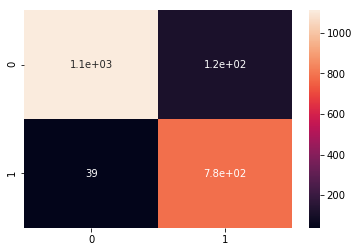

In [40]:
sns.heatmap(pd.DataFrame(cm), annot=True)

In [41]:
from sklearn.metrics import classification_report
print(classification_report(Y_test, Y_pred_ranfor))

              precision    recall  f1-score   support

         0.0       0.97      0.91      0.94      1226
         1.0       0.87      0.95      0.91       824

    accuracy                           0.92      2050
   macro avg       0.92      0.93      0.92      2050
weighted avg       0.93      0.92      0.93      2050



In [45]:
from sklearn import tree

i_tree = 0
for tree_in_forest in ranfor.estimators_:
    name_file = f'output/tree_{i_tree}.dot'
    with open(name_file, 'w') as my_file:
        my_file = tree.export_graphviz(tree_in_forest, out_file = my_file)        
    i_tree = i_tree + 1
  